In [30]:
import os
import numpy as np 
import random
from PIL import Image , ImageOps
import matplotlib.pyplot as plt
import tensorflow as tf 
from glob import glob
from tensorflow import keras 
from tensorflow.keras import layers
from tensorflow.keras.losses import MeanAbsoluteError,MeanSquaredError
import cv2

# CREATING THE DATASET

In [31]:
IMAGE_SIZE = 256
BATCH_SIZE = 16
MAX_TRAIN_IMAGES = 400

def preprocess_image(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    image = image / 255.0
    return image

def load_and_preprocess_data(low_light_paths, high_light_paths):
    low_light_images = [preprocess_image(path) for path in low_light_paths]
    high_light_images = [preprocess_image(path) for path in high_light_paths]
    return tf.data.Dataset.from_tensor_slices((low_light_images, high_light_images))

def paired_data_generator(low_light_paths, high_light_paths):
    dataset = load_and_preprocess_data(low_light_paths, high_light_paths)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset

# Example paths (replace with actual paths)
train_low_light_images = ['/kaggle/input/lol-dataset/lol_dataset/our485/low/' + img for img in os.listdir('/kaggle/input/lol-dataset/lol_dataset/our485/low/')[:MAX_TRAIN_IMAGES]]
train_high_light_images = ['/kaggle/input/lol-dataset/lol_dataset/our485/high/' + img for img in os.listdir('/kaggle/input/lol-dataset/lol_dataset/our485/high/')[:MAX_TRAIN_IMAGES]]
val_low_light_images = ['/kaggle/input/lol-dataset/lol_dataset/our485/low/' + img for img in os.listdir('/kaggle/input/lol-dataset/lol_dataset/our485/low/')[MAX_TRAIN_IMAGES:]]  
val_high_light_images = ['/kaggle/input/lol-dataset/lol_dataset/our485/high/' + img for img in os.listdir('/kaggle/input/lol-dataset/lol_dataset/our485/high/')[MAX_TRAIN_IMAGES:]]  
test_low_light_images = ['/kaggle/input/lol-dataset/lol_dataset/eval15/low/' + img for img in os.listdir('/kaggle/input/lol-dataset/lol_dataset/eval15/low/')]
test_high_light_images = ['/kaggle/input/lol-dataset/lol_dataset/eval15/high/' + img for img in os.listdir('/kaggle/input/lol-dataset/lol_dataset/eval15/high/')]

# Create datasets
train_dataset = paired_data_generator(train_low_light_images, train_high_light_images)
val_dataset = paired_data_generator(val_low_light_images, val_high_light_images)
test_dataset = paired_data_generator(test_low_light_images, test_high_light_images)

print("Train Dataset:", train_dataset)
print("Validation Dataset:", val_dataset)
print("Test Dataset:", test_dataset)


Train Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None))>
Validation Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None))>
Test Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None))>


# NETWORK FUNCTION

In [32]:

def build_dce_net():
    input_img = keras.Input(shape=[None, None, 3])
    conv1 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(input_img)
    conv2 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv1)
    conv3 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv2)
    conv4 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(conv3)
    int_con1 = layers.Concatenate(axis=-1)([conv4, conv3])
    conv5 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con1)
    int_con2 = layers.Concatenate(axis=-1)([conv5, conv2])
    conv6 = layers.Conv2D(
        32, (3, 3), strides=(1, 1), activation="relu", padding="same"
    )(int_con2)
    int_con3 = layers.Concatenate(axis=-1)([conv6, conv1])
    x_r = layers.Conv2D(24, (3, 3), strides=(1, 1), activation="tanh", padding="same")(
        int_con3
    )
    return keras.Model(inputs=input_img, outputs=x_r)


# LOSS FUNCTIONS

In [33]:

def color_constancy_loss(x):
    mean_rgb = tf.reduce_mean(x, axis=(1, 2), keepdims=True)
    mr, mg, mb = mean_rgb[:, :, :, 0], mean_rgb[:, :, :, 1], mean_rgb[:, :, :, 2]
    d_rg = tf.square(mr - mg)
    d_rb = tf.square(mr - mb)
    d_gb = tf.square(mb - mg)
    return tf.sqrt(tf.square(d_rg) + tf.square(d_rb) + tf.square(d_gb))



def exposure_loss(x, mean_val=0.6):
    x = tf.reduce_mean(x, axis=3, keepdims=True)
    mean = tf.nn.avg_pool2d(x, ksize=16, strides=16, padding="VALID")
    return tf.reduce_mean(tf.square(mean - mean_val))



def illumination_smoothness_loss(x):
    batch_size = tf.shape(x)[0]
    h_x = tf.shape(x)[1]
    w_x = tf.shape(x)[2]
    count_h = (tf.shape(x)[2] - 1) * tf.shape(x)[3]
    count_w = tf.shape(x)[2] * (tf.shape(x)[3] - 1)
    h_tv = tf.reduce_sum(tf.square((x[:, 1:, :, :] - x[:, : h_x - 1, :, :])))
    w_tv = tf.reduce_sum(tf.square((x[:, :, 1:, :] - x[:, :, : w_x - 1, :])))
    batch_size = tf.cast(batch_size, dtype=tf.float32)
    count_h = tf.cast(count_h, dtype=tf.float32)
    count_w = tf.cast(count_w, dtype=tf.float32)
    return 2 * (h_tv / count_h + w_tv / count_w) / batch_size



class SpatialConsistencyLoss(keras.losses.Loss):
    def __init__(self, **kwargs):
        super(SpatialConsistencyLoss, self).__init__(reduction="none")

        self.left_kernel = tf.constant(
            [[[[0, 0, 0]], [[-1, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.right_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, -1]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.up_kernel = tf.constant(
            [[[[0, -1, 0]], [[0, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.down_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, 0]], [[0, -1, 0]]]], dtype=tf.float32
        )

    def call(self, y_true, y_pred):

        original_mean = tf.reduce_mean(y_true, 3, keepdims=True)
        enhanced_mean = tf.reduce_mean(y_pred, 3, keepdims=True)
        original_pool = tf.nn.avg_pool2d(
            original_mean, ksize=4, strides=4, padding="VALID"
        )
        enhanced_pool = tf.nn.avg_pool2d(
            enhanced_mean, ksize=4, strides=4, padding="VALID"
        )

        d_original_left = tf.nn.conv2d(
            original_pool, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_right = tf.nn.conv2d(
            original_pool, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_up = tf.nn.conv2d(
            original_pool, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_down = tf.nn.conv2d(
            original_pool, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_enhanced_left = tf.nn.conv2d(
            enhanced_pool, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_right = tf.nn.conv2d(
            enhanced_pool, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_up = tf.nn.conv2d(
            enhanced_pool, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_down = tf.nn.conv2d(
            enhanced_pool, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_left = tf.square(d_original_left - d_enhanced_left)
        d_right = tf.square(d_original_right - d_enhanced_right)
        d_up = tf.square(d_original_up - d_enhanced_up)
        d_down = tf.square(d_original_down - d_enhanced_down)
        return d_left + d_right + d_up + d_down


def ssim(y_true, y_pred):
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, max_val=1.0))

mse = MeanSquaredError()
mae = MeanAbsoluteError()
def supervised_loss(y_true,y_pred):
    return mse(y_true,y_pred) + 0.1* mae(y_true,y_pred)

from tensorflow.keras.applications import VGG19
from tensorflow.keras.losses import MeanSquaredError
vggg = VGG19(include_top=False, weights='imagenet')
def perceptual_loss(y_true, y_pred):
    vgg = vggg
    vgg.trainable = False
    content_layers = ['block5_conv2']  
    outputs = [vgg.get_layer(name).output for name in content_layers]
    model = keras.Model([vgg.input], outputs)
    true_features = model(y_true)
    pred_features = model(y_pred)
    return mse(true_features, pred_features)



# THE DCE MODEL subclassing NEURAL NET

In [73]:
import tensorflow as tf
from tensorflow import keras
@tf.keras.utils.register_keras_serializable()
class ZeroDCE(keras.Model):
    def __init__(self, **kwargs):
        super(ZeroDCE, self).__init__(**kwargs)
        self.dce_model = build_dce_net()

    def compile(self, learning_rate, **kwargs):
        super(ZeroDCE, self).compile(**kwargs)
        self.optimizer = keras.optimizers.Adam(learning_rate=learning_rate)
        self.spatial_constancy_loss = SpatialConsistencyLoss(reduction="none")

    def get_enhanced_image(self, low_light, output):
        r1 = output[:, :, :, :3]
        r2 = output[:, :, :, 3:6]
        r3 = output[:, :, :, 6:9]
        r4 = output[:, :, :, 9:12]
        r5 = output[:, :, :, 12:15]
        r6 = output[:, :, :, 15:18]
        r7 = output[:, :, :, 18:21]
        r8 = output[:, :, :, 21:24]
        x = low_light + r1 * (tf.square(low_light) - low_light)
        x = x + r2 * (tf.square(x) - x)
        x = x + r3 * (tf.square(x) - x)
        enhanced_image = x + r4 * (tf.square(x) - x)
        x = enhanced_image + r5 * (tf.square(enhanced_image) - enhanced_image)
        x = x + r6 * (tf.square(x) - x)
        x = x + r7 * (tf.square(x) - x)
        enhanced_image = x + r8 * (tf.square(x) - x)
        return enhanced_image

    def call(self, low_light):
        dce_net_output = self.dce_model(low_light)
        return self.get_enhanced_image(low_light, dce_net_output)

    def compute_losses(self, low_light, output, high_light):
        enhanced_image = self.get_enhanced_image(low_light, output)
        loss_illumination = 200 * illumination_smoothness_loss(output)
        loss_spatial_constancy = tf.reduce_mean(self.spatial_constancy_loss(enhanced_image, low_light))
        loss_color_constancy = 5 * tf.reduce_mean(color_constancy_loss(enhanced_image))
        loss_exposure = 10 * tf.reduce_mean(exposure_loss(enhanced_image))
        loss_supervised = 26 * supervised_loss(high_light, enhanced_image)
        loss_perceptual = 7 * tf.reduce_mean(perceptual_loss(high_light, enhanced_image))
        loss_ssim = 9*ssim(high_light,enhanced_image)
        total_loss = (loss_illumination 
         + loss_spatial_constancy 
         + loss_color_constancy 
         + loss_exposure 
         + loss_supervised 
         + loss_perceptual
         + loss_ssim )
        return {"total_loss": total_loss, "illumination_smoothness_loss": loss_illumination,
                "spatial_constancy_loss": loss_spatial_constancy, "color_constancy_loss": loss_color_constancy,
                "exposure_loss": loss_exposure, "supervised_loss": loss_supervised, "perceptual_loss": loss_perceptual,
                "ssim_loss": loss_ssim}


    def train_step(self, data):
        low_light, high_light = data  # Unpack the input data
        with tf.GradientTape() as tape:
            output = self.dce_model(low_light)
            losses = self.compute_losses(low_light, output, high_light)
        gradients = tape.gradient(
            losses["total_loss"], self.dce_model.trainable_weights
        )
        self.optimizer.apply_gradients(zip(gradients, self.dce_model.trainable_weights))
        return losses

    def test_step(self, data):
        low_light, high_light = data  # Unpack the input data
        output = self.dce_model(low_light)
        return self.compute_losses(low_light, output, high_light)



In [35]:
zero_dce_model = ZeroDCE()
zero_dce_model.compile(learning_rate=1e-4) 

In [40]:
history = zero_dce_model.fit(train_dataset,validation_data = val_dataset ,epochs=60)


Epoch 1/60
25/25 ━━━━━━━━━━━━━━━━━━━━ 27s 709ms/step - color_constancy_loss: 0.0027 - exposure_loss: 2.9291 - illumination_smoothness_loss: 2.0923 - perceptual_loss: 4.1974 - spatial_constancy_loss: 3.6800e-05 - ssim_loss: 7.3581 - supervised_loss: 5.9885 - total_loss: 22.5682 - val_color_constancy_loss: 8.4542e-04 - val_exposure_loss: 2.8966 - val_illumination_smoothness_loss: 1.3023 - val_perceptual_loss: 4.3800 - val_spatial_constancy_loss: 6.4894e-05 - val_ssim_loss: 7.4007 - val_supervised_loss: 6.1531 - val_total_loss: 22.1336
Epoch 2/60
25/25 ━━━━━━━━━━━━━━━━━━━━ 14s 580ms/step - color_constancy_loss: 0.0030 - exposure_loss: 2.8857 - illumination_smoothness_loss: 1.3900 - perceptual_loss: 4.0962 - spatial_constancy_loss: 2.8475e-04 - ssim_loss: 7.2349 - supervised_loss: 5.8604 - total_loss: 21.4703 - val_color_constancy_loss: 0.0011 - val_exposure_loss: 2.8371 - val_illumination_smoothness_loss: 0.9923 - val_perceptual_loss: 4.2457 - val_spatial_constancy_loss: 4.3579e-04 - val_

# Loss Curves 

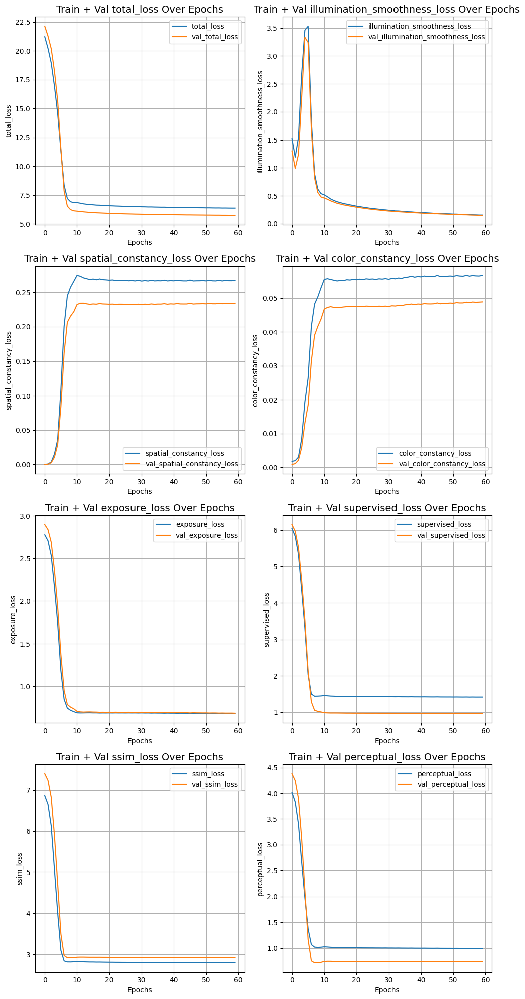

In [44]:
import matplotlib.pyplot as plt

def plot_results(history, items):
    num_items = len(items)
    rows = 4
    cols = 2
    fig, axes = plt.subplots(rows, cols, figsize=(5 * cols, 5 * rows))
    
    axes = axes.flatten()  # Flatten the 2D array to make it easier to iterate
    
    for ax, item in zip(axes, items):
        ax.plot(history.history[item], label=item)
        ax.plot(history.history["val_" + item], label="val_" + item)
        ax.set_xlabel("Epochs")
        ax.set_ylabel(item)
        ax.set_title("Train + Val {} Over Epochs".format(item), fontsize=14)
        ax.legend()
        ax.grid()

    # Hide any unused subplots
    for ax in axes[num_items:]:
        ax.axis('off')
    
    plt.tight_layout()
    plt.show()

# Example usage assuming `history` contains the training history object
items_to_plot = ["total_loss", "illumination_smoothness_loss", "spatial_constancy_loss", "color_constancy_loss", "exposure_loss", "supervised_loss", "ssim_loss", "perceptual_loss"]
plot_results(history, items_to_plot)


# Post Processing and Infer function 

In [50]:
import cv2
import numpy as np
import tensorflow as tf
from PIL import Image
import matplotlib.pyplot as plt

    
def apply_gaussian_blur(image, kernel_size=(3, 3), sigma=0.6):
    image_np = np.array(image)
    blurred_image_np = cv2.GaussianBlur(image_np, kernel_size, sigma)
    return blurred_image_np
    
def post_process(image):
    image_np = np.array(image)
    denoised_image = cv2.fastNlMeansDenoisingColored(image_np, None, 7, 7, 5 ,5)
    denoised_image = apply_gaussian_blur(denoised_image)
    return Image.fromarray(denoised_image)    

def infer(original_image):
    image = tf.keras.preprocessing.image.img_to_array(original_image.convert('RGB'))  # Ensure RGB mode
    image = image.astype("float32") / 255.0
    image = np.expand_dims(image, axis=0)
    output_image = zero_dce_model(image)
    output_image_np = np.uint8(output_image[0] * 255)
    output_image_pil = Image.fromarray(output_image_np)
    output_image_pil = post_process(output_image_pil) 
    return output_image_pil




# Check on the quality of Images 

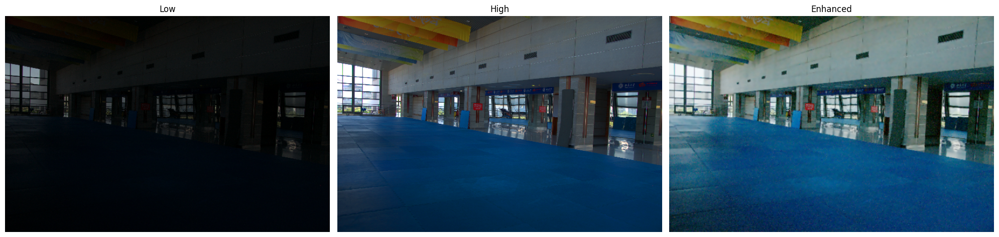

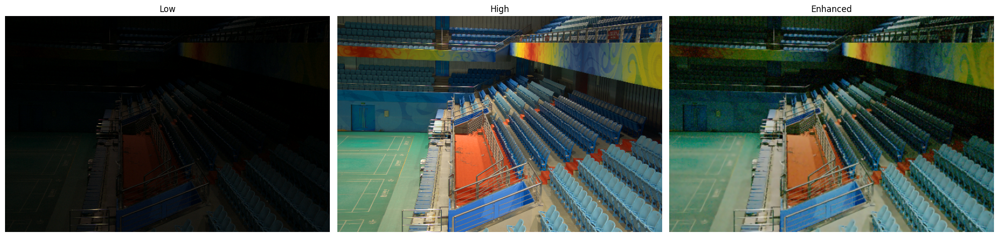

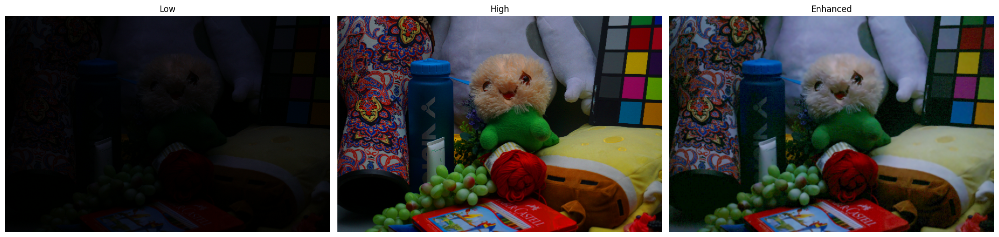

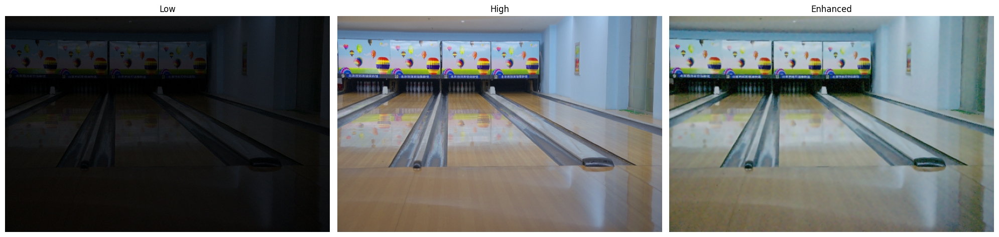

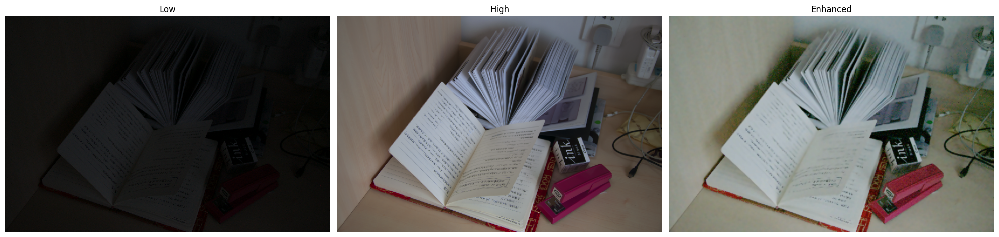

...

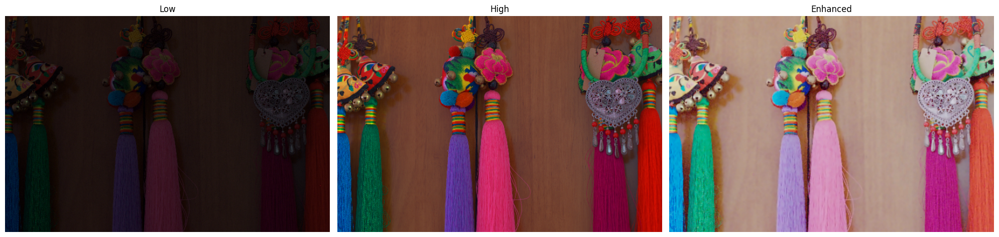

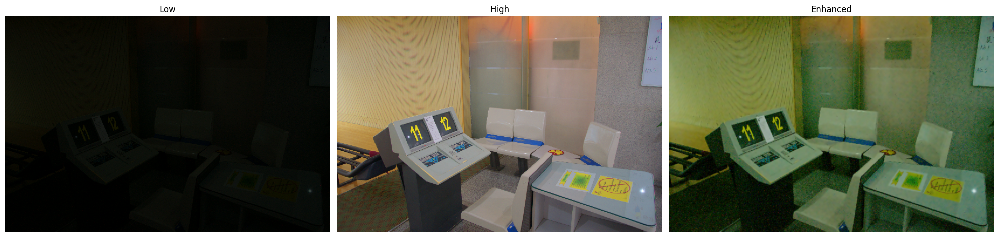

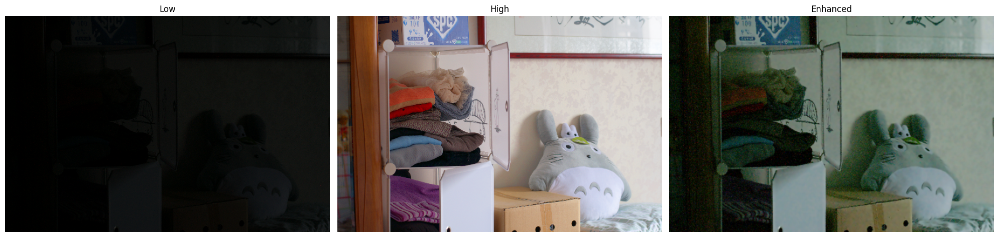

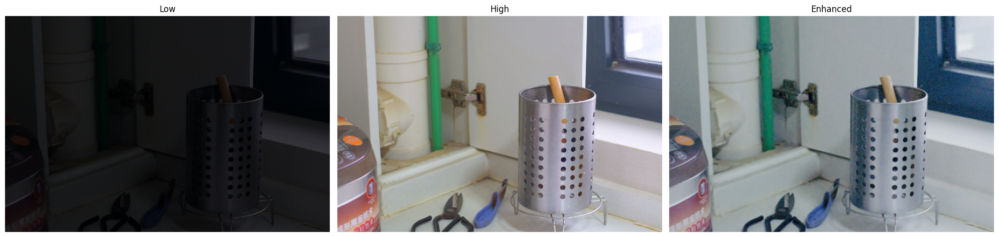

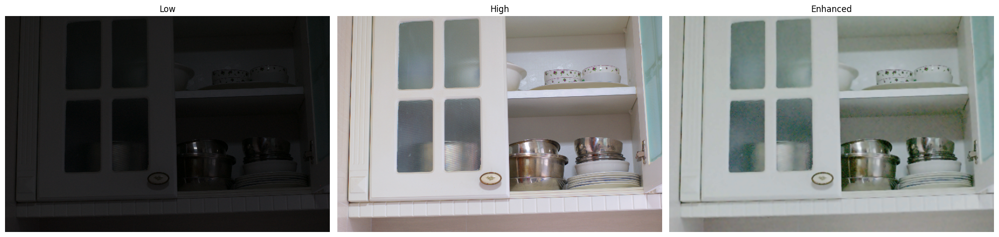

In [51]:
for val_image_file,test_high_file in zip(test_low_light_images,test_high_light_images):
    original_image = Image.open(val_image_file)
    enhanced_image = infer(original_image)
    high_image = Image.open(test_high_file)
    plot_results(
        [original_image, high_image, enhanced_image],
        ["Low", "High", "Enhanced"],
        (20, 12),
    )

In [52]:
from skimage.metrics import peak_signal_noise_ratio as psnr

# Calculation of PSNR 

In [56]:
# Initialize lists for storing PSNR values
psnr_values = []
# Iterate through test images
for val_image_file, high_light_file in zip(val_low_light_images, val_high_light_images):
    original_image = Image.open(val_image_file) 
    enhanced_image = infer(original_image)
    original_np = np.array(original_image)
    enhanced_np = np.array(enhanced_image)
    high_light = Image.open(high_light_file)
    high_light_np = np.array(high_light)
    psnr1 = psnr(enhanced_np,high_light_np)
    psnr_values.append(psnr1)


# Calculate mean and median PSNR
mean_psnr = np.mean(psnr_values)
median_psnr = np.median(psnr_values)
min_psnr = np.min(psnr_values)
max_psnr = np.max(psnr_values)
print(f"Mean PSNR: {mean_psnr:.2f}")
print(f"Median PSNR: {median_psnr:.2f}")
print(f"Min PSNR: {min_psnr:.2f}")
print(f"Max PSNR: {max_psnr:.2f}")


Mean PSNR: 17.50
Median PSNR: 17.66
Min PSNR: 6.00
Max PSNR: 26.30


In [57]:
psnr_values

[15.313002335837165,
 16.08525378779825,
 25.20669132044086,
 20.21451891310962,
 20.69349587694927,
 19.668012066536473,
 15.6630774448507,
 7.825112507823546,
 23.78482338524542,
 7.191590761227637,
 17.03124307233155,
 22.29546320868272,
 13.758364491736918,
 15.640169544359711,
 21.08102893875209,
 16.351175626701608,
 9.89551932588837,
 21.028092585491557,
 5.996858485058814,
 11.914938402391178,
 25.059732197056714,
 16.62197111722671,
 24.31724646467478,
 15.536786059509557,
 21.609366503167024,
 22.261879946070813,
 11.584160750171481,
 25.52539182170172,
 20.605149684179274,
 20.039787869871265,
 19.147310480408944,
 17.427547622119043,
 6.51882275514819,
 7.158053577667246,
 20.64842760123429,
 13.751536948513724,
 16.161075331699223,
 23.828442515981656,
 18.330521683837414,
 23.049360706112303,
 22.48526472615316,
 21.76741849280351,
 15.453892266976075,
 13.943927168294021,
 9.460847576682792,
 13.638573216705975,
 17.655971281079275,
 20.756846430533656,
 12.9340363586702

# Using different color space 

# For hyperparameter tuning 

In [ ]:
# from tensorflow.keras.metrics import MeanSquaredError, MeanAbsoluteError
# import tensorflow as tf
# from tensorflow import keras
# import keras_tuner as kt

# class ZeroDCE(keras.Model):
#     def __init__(self, loss_weights, **kwargs):
#         super(ZeroDCE, self).__init__(**kwargs)
#         self.dce_model = build_dce_net()
#         self.loss_weights = loss_weights

#     def compile(self, learning_rate, **kwargs):
#         super(ZeroDCE, self).compile(**kwargs)
#         self.optimizer = keras.optimizers.Adam(learning_rate=learning_rate)
#         self.spatial_constancy_loss = SpatialConsistencyLoss(reduction="none")

#     def get_enhanced_image(self, low_light, output):
#         r1 = output[:, :, :, :3]
#         r2 = output[:, :, :, 3:6]
#         r3 = output[:, :, :, 6:9]
#         r4 = output[:, :, :, 9:12]
#         r5 = output[:, :, :, 12:15]
#         r6 = output[:, :, :, 15:18]
#         r7 = output[:, :, :, 18:21]
#         r8 = output[:, :, :, 21:24]
#         x = low_light + r1 * (tf.square(low_light) - low_light)
#         x = x + r2 * (tf.square(x) - x)
#         x = x + r3 * (tf.square(x) - x)
#         enhanced_image = x + r4 * (tf.square(x) - x)
#         x = enhanced_image + r5 * (tf.square(enhanced_image) - enhanced_image)
#         x = x + r6 * (tf.square(x) - x)
#         x = x + r7 * (tf.square(x) - x)
#         enhanced_image = x + r8 * (tf.square(x) - x)
#         return enhanced_image
    
#     def call(self, low_light):
#         dce_net_output = self.dce_model(low_light)
#         return self.get_enhanced_image(low_light, dce_net_output)

#     def compute_losses(self, low_light, output, high_light):
#         enhanced_image = self.get_enhanced_image(low_light, output)
#         loss_illumination = 200 * illumination_smoothness_loss(output)
#         loss_spatial_constancy = tf.reduce_mean(self.spatial_constancy_loss(enhanced_image, low_light))
#         loss_color_constancy = 5 * tf.reduce_mean(color_constancy_loss(enhanced_image))
#         loss_exposure = 10 * tf.reduce_mean(exposure_loss(enhanced_image))
#         loss_supervised = self.loss_weights['supervised'] * supervised_loss(high_light, enhanced_image)
#         loss_perceptual = self.loss_weights['perceptual'] * tf.reduce_mean(perceptual_loss(high_light, enhanced_image))
#         loss_ssim = self.loss_weights['ssim'] * ssim(high_light, enhanced_image)
        
#         total_loss = (loss_illumination 
#                       + loss_spatial_constancy 
#                       + loss_color_constancy 
#                       + loss_exposure 
#                       + loss_supervised 
#                       + loss_perceptual
#                       + loss_ssim)
                      
#         return {"total_loss": total_loss, "illumination_smoothness_loss": loss_illumination,
#                 "spatial_constancy_loss": loss_spatial_constancy, "color_constancy_loss": loss_color_constancy,
#                 "exposure_loss": loss_exposure, "supervised_loss": loss_supervised, "perceptual_loss": loss_perceptual,
#                 "ssim_loss": loss_ssim}

#     def train_step(self, data):
#         low_light, high_light = data
#         with tf.GradientTape() as tape:
#             output = self.dce_model(low_light)
#             losses = self.compute_losses(low_light, output, high_light)
#         gradients = tape.gradient(
#             losses["total_loss"], self.dce_model.trainable_weights
#         )
#         self.optimizer.apply_gradients(zip(gradients, self.dce_model.trainable_weights))
#         return losses

#     def test_step(self, data):
#         low_light, high_light = data
#         output = self.dce_model(low_light)
#         return self.compute_losses(low_light, output, high_light)

#     def save_weights(self, filepath, overwrite=True, save_format=None, options=None):
#         self.dce_model.save_weights(filepath, overwrite=overwrite, save_format=save_format, options=options)

#     def load_weights(self, filepath, by_name=False, skip_mismatch=False, options=None):
#         self.dce_model.load_weights(filepath=filepath, by_name=by_name, skip_mismatch=skip_mismatch, options=options)
